# <center> SBERT with Reduced Dimensionality Embeddings </center>

#### <center> Cayden Blake </center>

Sentence and word embeddings are powerful tools for natural language processing. They allow us to represent the meanings of words and sentences as vectors in a high dimensional space. These vectors can then be used to perform a variety of useful tasks, often by comparing the similarity of words and sentences in the embedding space. A lot of work has been done recently with vector databases, where sentence or document embedding vectors are stored so that they can be compared to new embedded sentences or documents. This allows us to perform tasks like semantic search, where we can find the most similar sentences or documents to a given query. However, because of the high dimensionality of these vectors, these databases can be very large and computationally expensive to search. 

Work has been done previously in reducing the dimensionality of these embeddings, such as in the BERTopic model, which uses UMAP in order to reduce the dimensionlity before clustering into topics. While this method is effective, unfortunately it is not helpful when we want to see the evolution of topics over time, as the UMAP reduction must be retrained each time new documents are added to the database, and the resulting embeddings are not comparable between different UMAP models. 

Here, we explore the use of a trained dimensionality reduction head on top of the BERT model so that our embeddings can be reduced to a fixed dimensionality, and then compared between different models. Pretraining for the dimensionality reduction head was done on the BERT model, fixing the base BERT model weights and only training the head. This allows us to use the same dimensionality reduction head on top of different BERT models, and compare the resulting embeddings.

For getting sentence embeddings, we will use the SBERT model with the learned dimensionality reduction head from our custom BERT model. We will then use the reduced dimensionality embeddings to cluster them into topics and compare the results of this model to the BERTopic model.

I am using the Huggingface ```transformers``` library as well as my own source code for reduced dimensionality encoder models. 
To see my source code, check out the `reduced_encoders` folder in my [GitHub](https://github.com/CayJoBla/BertReducedModel) repo.

## Load the Reduced SBERT Model

#### Look at the structure of the reduced BERT model

In [1]:
from reduced_encoders import BertReducedModel

bert_reduced = BertReducedModel.from_pretrained('cayjobla/bert-base-uncased-reduced')
bert_reduced

BertReducedModel(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_

As you can see above, we modified the BERT model to include a dimensionality reduction head on top of the BERT model. This reduction is a series of dense linear layers, reducing the dimensionality of the embeddings from 768 to 512 to 256 to 128 to 64 to 48. Since this reduction module was pretrained while the base BERT model weights were frozen, we can use this reduction module on top of any BERT model to reduce the dimensionality of the embeddings.

#### Add the dimensionality reduction head to the SBERT model

In [2]:
from reduced_encoders import SBertMPNetReducedModel

sbert_reduced = SBertMPNetReducedModel.from_pretrained("sentence-transformers/all-mpnet-base-v2", 
                                                        reduce_module='cayjobla/bert-base-uncased-reduced')
sbert_reduced

SBertMPNetReducedModel(
  (sbert): MPNetModel(
    (embeddings): MPNetEmbeddings(
      (word_embeddings): Embedding(30527, 768, padding_idx=1)
      (position_embeddings): Embedding(514, 768, padding_idx=1)
      (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): MPNetEncoder(
      (layer): ModuleList(
        (0-11): 12 x MPNetLayer(
          (attention): MPNetAttention(
            (attn): MPNetSelfAttention(
              (q): Linear(in_features=768, out_features=768, bias=True)
              (k): Linear(in_features=768, out_features=768, bias=True)
              (v): Linear(in_features=768, out_features=768, bias=True)
              (o): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inplace=False)
         

In [3]:
from reduced_encoders.debug_utils import compare_weights

# Compare the weights of the reduce module between the two models
compare_weights(bert_reduced.reduce, sbert_reduced.reduce)

True

In [4]:
from transformers import AutoModel

# Compare the weights of the base SBERT model to our reduced SBERT model
sbert = AutoModel.from_pretrained("sentence-transformers/all-mpnet-base-v2", add_pooling_layer=False)
compare_weights(sbert, sbert_reduced.sbert)

True

Thus, we were able to successfully load the pretrained reduction weights of our custom BERT model onto the SBERT model while keeping the pretrained weights for the base SBERT model. This allows us to use the SBERT model to get sentence embeddings, and then reduce the dimensionality of those embeddings to 48 dimensions.

#### Get the Fine-Tuned SBERT Reduced Model

In order to ensure that the reduction works well for generating sentence embeddings, the entire reduced SBERT model was fine-tuned on the GLUE benchmark datasets for a variety of sentence classification tasks. The model was then saved and is loaded here for use in generating sentence embeddings.

In [5]:
from reduced_encoders import SBertMPNetReducedModel

# Ignore the warning: We don't need the classifier head for sentence embeddings
sbert_reduced_tuned = SBertMPNetReducedModel.from_pretrained("cayjobla/all-mpnet-base-v2-reduced", revision='glue') 
sbert_reduced_tuned

Some weights of the model checkpoint at cayjobla/all-mpnet-base-v2-reduced were not used when initializing SBertMPNetReducedModel: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing SBertMPNetReducedModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SBertMPNetReducedModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


SBertMPNetReducedModel(
  (sbert): MPNetModel(
    (embeddings): MPNetEmbeddings(
      (word_embeddings): Embedding(30527, 768, padding_idx=1)
      (position_embeddings): Embedding(514, 768, padding_idx=1)
      (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): MPNetEncoder(
      (layer): ModuleList(
        (0-11): 12 x MPNetLayer(
          (attention): MPNetAttention(
            (attn): MPNetSelfAttention(
              (q): Linear(in_features=768, out_features=768, bias=True)
              (k): Linear(in_features=768, out_features=768, bias=True)
              (v): Linear(in_features=768, out_features=768, bias=True)
              (o): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inplace=False)
         

## Generate Sentence Embeddings

We compare the embeddings of the out of the box BERTopic model with our reduced dimensionality SBERT model. We will use the same dataset for both models, and compare the resulting embeddings.

#### Get Toy Dataset

In [6]:
from sklearn.datasets import fetch_20newsgroups

newsgroups = fetch_20newsgroups()
documents = newsgroups.data

#### BERTopic Embeddings

To use the BERTopic model, we must provide the high-dimensional embeddings of the sentences from a sentence transformer model. We can get these embeddings from the base SBERT model using `sentence-transformers` library.

In [7]:
# !pip install BERTopic
# !pip install sentence-transformers

In [8]:
from sentence_transformers import SentenceTransformer

# Get the embeddings for the text
embeddings = SentenceTransformer("all-mpnet-base-v2").encode(documents)

In [9]:
# Look at the size of the embeddings
embeddings.shape

(11314, 768)

In [10]:
from bertopic import BERTopic

# Train BERTopic
topic_model = BERTopic().fit(documents, embeddings)

In [11]:
import numpy as np

print("Number of clusters:", len(np.unique(topic_model.topics_)))

Number of clusters: 260


In [12]:
# Visualize the topics
hierarchical_topics = topic_model.hierarchical_topics(documents)
topic_model.visualize_hierarchical_documents(documents, hierarchical_topics, embeddings=embeddings)

100%|██████████| 258/258 [00:01<00:00, 158.26it/s]


Interestingly, the BERTopic model out of the box determines the topics by using the TF-IDF vectorization of the document words, and then using those rankings to determine a group of the most likely topics for each document. Unfortunately, this method of determining topics has not been implemented yet for the reduced dimensionality SBERT model, and so we will only look at the reduced embeddings themselves.

#### Our Reduced SBERT Embeddings

In [13]:
from transformers import AutoTokenizer, AutoModel

import torch
from tqdm import tqdm
from hdbscan import HDBSCAN
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

class BERTopicReduced():
    def __init__(self, model=None, tokenizer=None, clustering_method=None, device=None):
        self.device = device or torch.device("cuda" if torch.cuda.is_available() else "cpu")
        default_model = "cayjobla/all-mpnet-base-v2-reduced"

        self.model = model or default_model
        if type(self.model) == str:
            default_model = self.model  # So that tokenizer matches model by default
            self.model = AutoModel.from_pretrained(self.model)
        self.model.to(self.device)

        self.tokenizer = tokenizer or default_model
        if type(self.tokenizer) == str:
            self.tokenizer = AutoTokenizer.from_pretrained(self.tokenizer)

        self.clustering_method = clustering_method or HDBSCAN(min_cluster_size=10, 
                                                                metric='euclidean', 
                                                                cluster_selection_method='eom')
        self.embeddings = None

    def batch(self, data, batch_size=16):
        for i in range(0, len(data), batch_size):
            yield data[i:i+batch_size]
            
    def embed(self, text, batch_size=16):
        embeddings = []
        progress_bar = tqdm(total=len(text), desc="Embedding text", position=0)

        p_bar = tqdm(range(len(text)), desc="Embedding text", leave=False)
        for batch in self.batch(text, batch_size=batch_size):
            inputs = self.tokenizer(batch, padding=True, truncation=True, return_tensors="pt").to(self.device)
            outputs = self.model(**inputs)
            embeddings += [*outputs.pooler_output.cpu().detach().numpy()]
            progress_bar.update(len(batch))
        progress_bar.close()

        self.embeddings = np.array(embeddings)
        return self

    def cluster(self, clustering_method=None, max_iter=100):
        if clustering_method is not None:
            self.clustering_method = clustering_method
        if self.embeddings is None:
            raise ValueError("Please embed the data first using the embed() method.")
        clusters = self.clustering_method.fit(self.embeddings)
        self.labels = clusters.labels_
        self.num_clusters = len(set(self.labels))
        return self

    def get_topics(self, text):
        raise NotImplementedError("This method is not implemented yet")

    def fit(self, text, batch_size=16, max_iter=1000):
        self.embed(text, batch_size=batch_size)
        self.cluster(max_iter=max_iter)
        return self
        

In [25]:
reduced_topic_model = BERTopicReduced(
    model=sbert_reduced_tuned, 
    tokenizer="cayjobla/all-mpnet-base-v2-reduced"
)

In [26]:
reduced_topic_model.embed(documents)
reduced_topic_model.embeddings.shape

Embedding text: 100%|██████████| 11314/11314 [01:54<00:00, 99.23it/s] 


(11314, 48)

In [27]:
reduced_topic_model.cluster()
labels, counts = np.unique(reduced_topic_model.labels, return_counts=True)
print("Labels:", labels)
print("Counts:", counts)

Labels: [-1  0  1]
Counts: [   71    31 11212]


In [28]:
from umap import UMAP
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
import pandas as pd

def visualize_space_2d(embeddings_2d, labels):
    """Plot the distribution of embedding vectors projected to 2 dimensions using UMAP."""
    df_emb = pd.DataFrame(embeddings_2d, columns=["X", "Y"])
    df_emb["label"] = labels

    # Plot
    num_labels = len(np.unique(labels))
    colors = ["C0", "C1", "C2", "C3", "C4", "C5", "C6", "C8", "C9"]
    for i, label in enumerate(np.unique(labels)):
        color = "C7" if label == -1 else colors[i%len(colors)]
        df_emb_sub = df_emb.query(f"label == {label}")
        plt.scatter(df_emb_sub["X"], df_emb_sub["Y"], c=color, alpha=0.1)
        plt.gca().set_aspect('equal', 'box')
    plt.tight_layout()
    plt.show()

In [29]:
embeddings_2d = UMAP().fit_transform(reduced_topic_model.embeddings)

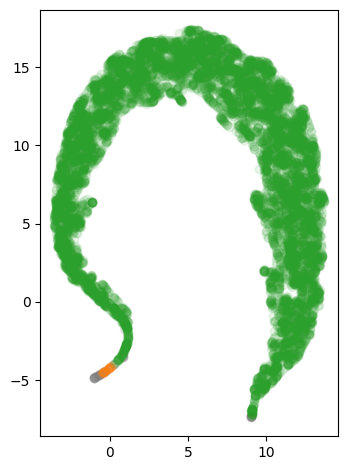

In [30]:
visualize_space_2d(embeddings_2d, reduced_topic_model.labels)

Labels: [-1  0  1  2  3  4  5  6  7  8  9]
Counts: [  216    10    40     9     5    12     5     7     7    15 10988]


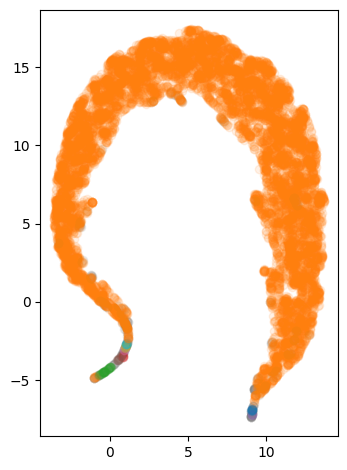

In [33]:
clustering_method = HDBSCAN(min_cluster_size=5, 
                            metric='euclidean', 
                            cluster_selection_method='eom')
reduced_topic_model.cluster(clustering_method=clustering_method)

labels, counts = np.unique(reduced_topic_model.labels, return_counts=True)
print("Labels:", labels)
print("Counts:", counts)

visualize_space_2d(embeddings_2d, reduced_topic_model.labels)

In [58]:
from bertopic import BERTopic

class RBERTopic(BERTopic):
    """Remove dimensionality reduction if the embeddings are reduced"""
    def _reduce_dimensionality(self, embeddings, y=None, partial_fit=False):
        """Check if the embedding model is a reduced model and if so, use the reduced embeddings, 
        else call the original method.
        """
        if embeddings.shape[1] <= 64:
            return embeddings
        return super()._reduce_dimensionality(documents, embeddings)
        

In [16]:
rbertopic = RBERTopic().fit(documents, reduced_topic_model2.embeddings)

In [17]:
print("Number of clusters:", len(np.unique(rbertopic.topics_)))

Number of clusters: 4


In [18]:
bertopic_w_reduced = BERTopic().fit(documents, reduced_topic_model2.embeddings)

In [19]:
print("Number of clusters:", len(np.unique(rbertopic.topics_)))

Number of clusters: 4


Here, our clustering algorithm gave us only 3 different clusters, where the BERTopic model had over 250 different clusters. The majority of the sentences are in the last cluster. It is difficult to tell what is happening in higher dimensions with the embeddings in order to determine what the actual embedding distribution looks like. Furthermore, since topic selection has not yet been implemented here, we cannot look directly at the topics that are generated by the clustering algorithm. However, we can look at the sentences that are in each cluster to see if there are any patterns that we can see.

#### Examining our Reduced SBERT clusters

We take a look at some example sentences from each cluster in order to see what the clusters look like and what the potential topic might be. It is of note that the -1 class is generally used by clustering algorithms to denote the items that do not fall within a cluster.

In [95]:
# Examples from the -1 class
cluster = -1
num_examples = 3
indices = np.where(reduced_topic_model.labels == cluster)[0]
picks = np.random.choice(indices, num_examples, replace=False)
for index in picks:
    print(f"Document {index+1}:")
    print(documents[index][:400]) # Only print the first 400 characters
    print("\n")

Document 5046:
From: mitchell@nodecg.ncc.telecomwa.oz.au (Clive Mitchell)
Subject: Dataproducts LZR1260 not printing correctly
Organization: Regional Network Systems Group, Perth
Lines: 948

---------- cut here ---------- part 03/03
M2C3,JSG  A\-\($J7LUS?30XC;16@"Y DK<(ME<#T(F6;;,3QX";>?H!80H(
MGNM U )D@/D&"!YW0"R"<T!2V<XLFP6#F9?P@A4&:'&B AD."/,( ,V1#&W;
M'<]6P- 3$BU['L:P$]FVI@<L8'Q"W\X&-AQ(LP,9VNF5[90%! ]HF&-8M


Document 449:
From: jodfishe@silver.ucs.indiana.edu (joseph dale fisher)
Subject: Re: Ancient Books
Organization: Indiana University
Lines: 8

Of course, I'd still recommend that Michael read _True and Reasonable_
by Douglas Jacoby.

Joe Fisher

Oh, and Michael, I wait to see any dents in any armor and my faith
hasn't wavered since the day I became a disciple.  You may want to try
it sometime.  It's life-changi


Document 8138:
From: LLARSEN@LMSC5.IS.LMSC.LOCKHEED.COM
Subject: >>> porsche 928<<
Organization: Lockheed Missiles & Space Company, Inc.
Lines: 6

posting for a frie

For this class, there seem to be a lot of listings for items being sold or bought, but as mentioned previously, this cluster index is often used for items that do not fall within a cluster. It is possible that this class is a catch-all for sentences that do not fit into the other clusters. This is supported by some other examples, such as the first of the above, which is a string of random symbols.

In [102]:
# Examples from the 0 class
cluster = 0
num_examples = 3
indices = np.where(reduced_topic_model.labels == cluster)[0]
picks = np.random.choice(indices, num_examples, replace=False)
for index in picks:
    print(f"Document {index+1}:")
    print(documents[index][:500]) # Only print the first 500 characters
    print("\n")

Document 1242:
From: sanjay@kin.lap.upenn.edu (Sanjay Sinha)
Subject: Re: New to Motorcycles...
Organization: University of Pennsylvania, Language Analysis Center
Lines: 18
Nntp-Posting-Host: kin.lap.upenn.edu

In article <13612@news.duke.edu> infante@acpub.duke.edu (Andrew  Infante) writes:
:>Curtis JAckson pens...
:>
:>"MSF course...$140"
:
:Shyah!
:
:The one here only costs $35!
:
:(Izzat a deal or what?! :)


They are free in Philadelphia....   :-)

-- 
   '81 CB650 						DoD #1224

	   I would give my rig


Document 6481:
From: boell@hpcc01.corp.hp.com (Donald P Boell)
Subject: Rockies opening day cast
Organization: the HP Corporate notes server
Lines: 34

Here is the Colorado Rockies openning day cast:

Pitchers
--------
Scott Aldred (L)  MLB Totals  31 games, 6-14, 5.08 ERA, 0 saves
Andy Ashby (R)                18 games, 2-8,  6.72 ERA, 0 saves
Willie Blair (R)              67 games, 10-15,4.57 ERA, 0 saves
Butch Henry (L)               28 games, 6-9,  4.02 ERA, 0 saves
Darren 

This topic seems to contain quite a few tables, generally with sports information; however, this cluster also contains some other sentences that do not seem to fit into this topic, such as forums for politics or other topics.

In [108]:
# Examples from the 1 class
cluster = 1
num_examples = 3
indices = np.where(reduced_topic_model.labels == cluster)[0]
picks = np.random.choice(indices, num_examples, replace=False)
for index in picks:
    print(f"Document {index+1}:")
    print(documents[index][:500]) # Only print the first 500 characters
    print("\n")

Document 242:
From: lmh@juliet.caltech.edu (Henling, Lawrence M.)
Subject: Re: catholic church poland
Organization: California Institute of Technology
Lines: 10

In article <Apr.20.03.01.44.1993.3772@geneva.rutgers.edu>, s0612596@let.rug.nl (M.M. Zwart) writes...
>I'm writing a paper on the role of the catholic church in Poland after 1989. 
>church concerning the abortion-law, religious education at schools,

 There was an article on clari.news.religion in the last few days about a
Polish tribunal decision. I


Document 6141:
From: tiang@midway.ecn.uoknor.edu (Tiang)
Subject: Re: A Book I found... graphics
Nntp-Posting-Host: midway.ecn.uoknor.edu
Organization: Engineering Computer Network, University of Oklahoma, Norman, OK, USA
Lines: 35

covlir@crockett1c.its.rpi.edu (Locks) writes:
Hello,

>I happened to spot an excellent book in a bookstore about 4 days ago,
>though!!!!!!  It is in C++ and assembly.  It teaches you the assembly
>as it goes along --so if you're like me and have no a

This class does not seem to have a clear pattern, with a variety of different topics. For example, I saw many documents about engineering or computer science, sports, religion, politics, and even a press release from the White House.

## Experiment: Using the Reduced SBERT embeddings with BERTopic

In [34]:
# Fit the BERTopic model with the reduced embeddings
topic_model = BERTopic()
topic_model.fit(documents, reduced_topic_model.embeddings)

In [35]:
print("Number of clusters:", len(np.unique(topic_model.topics_)))

Number of clusters: 228


In [36]:
# Visualize the topics
hierarchical_topics = topic_model.hierarchical_topics(documents)
topic_model.visualize_hierarchical_documents(documents, hierarchical_topics, embeddings=embeddings)

100%|██████████| 226/226 [00:01<00:00, 160.72it/s]


It appears that the clustering algorithm is not working well with the reduced dimensionality embeddings. Though there are some places that appear to represent potential clusters, the documents in the entire space appear to be randomly assigned to clusters without any clear pattern. Perhaps the parameters of the clustering algorithm need to be adjusted to work with the reduced dimensionality embeddings.

## Conclusion

From these results, it appears that while our reduced dimensionality SBERT model is able to generate sentence embeddings with a lower dimensionality, the resulting embeddings are not currently as useful as those generated by the BERTopic model. The BERTopic model generates a clustering of the documents with over 250 different topics, while our reduced dimensionality SBERT model only generates 3 topics. Furthermore, in its current state, the reduced dimensionality SBERT model does not have a way to determine the topics of the clusters, and so we cannot directly compare the topics generated by the two models. 

When using the reduced dimensionality embeddings in the BERTopic model, the clustering algorithm appears to randomly assign each document to a group. This plus the fact that the reduced-dimensionality SBERT model achieves very similar results on GLUE tasks when compared to the base SBERT model, leads me to believe that the difficulties currently lie with the way clustering is being done, rather than with the embeddings themselves. Perhaps the parameters of the clustering algorithm need to be adjusted for the reduced embeddings. It is possible that with some further work, we could get the reduced dimensionality SBERT model to perform as well as the BERTopic model.